In [1]:
import bokeh.plotting as bpl
import cv2
import glob
import logging
import matplotlib.pyplot as plt
import numpy as np
import os
import re
try:
    cv2.setNumThreads(0)
except():
    pass

try:
    if __IPYTHON__:
        # this is used for debugging purposes only. allows to reload classes
        # when changed
        get_ipython().magic('load_ext autoreload')
        get_ipython().magic('autoreload 2')
except NameError:
    pass

import caiman as cm
from caiman.source_extraction import cnmf as cnmf
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import params as params
from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
from caiman.utils.visualization import inspect_correlation_pnr, nb_inspect_correlation_pnr
bpl.output_notebook()

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-

Loading BokehJS ...

In [2]:

pathname='/home/qiushou/HBRdata/2p_data/F2_2WAY_T7000'
filename='myMultiImages.tif'
tsname=os.path.join(pathname,'timestamp.dat')
newpath_parent=os.path.join(pathname,'Results_CNMF')
if not os.path.exists(newpath_parent):
    os.makedirs(newpath_parent)

fnames=[os.path.join(pathname,filename)]
fnames
m_orig = cm.load_movie_chain(fnames)
np.shape(m_orig)
downsample_ratio = .5 # motion can be perceived better when downsampling in time
# play examples
m_orig.resize(1, 1, downsample_ratio).play(q_max=99.5, fr=20, magnification=1)   # play movie (press q to exit)        
# for file in filename:
#     filenum.append(int(re.split(r'(\d+)',file.rsplit('/',-1)[-1].rsplit('.',1)[0])[1]))
# msFileList=[filename[i] for i in np.argsort(filenum)]
# msFileList

100%|██████████| 1/1 [00:13<00:00, 13.74s/it]


In [3]:
# #%% concatenate timestamps of tsFileList
# ms_ts_name = os.path.join(pathname,'ms_ts.pkl')
# temporal_downsampling=3                   
# import pandas as pd
# import pickle 
# import numpy as np
# if not os.path.exists(ms_ts_name):
#     ts_sessions=[]  
#     for tsFile in tsFileList:
#         datatemp=pd.read_csv(tsFile,sep = "\t", header = 0)
#         ts_sessions.append(datatemp['sysClock'].values) 
# #         print(len((datatemp['sysClock'].values)))
#     ts_all=np.hstack(ts_sessions)[::temporal_downsampling]#downsampled timestamps of all the blocks
#     # remporally downsample for each video
#     # [i[::3] for i in ts_sessions][0]
#     ts_breakpoints=(np.where(np.diff(ts_all)<0)[0]).tolist()# ts_breakpoints means the location of the lagest timepoint of each session
# #     print(ts_breakpoints)
#     ends = np.add(ts_breakpoints,1)
#     starts = np.insert(ends,0,0)
#     ts_blocks=[]
#     for start,end in zip(starts,ends):
#         ts_blocks.append(ts_all[start:end])
            
#     ts_blocks.append(ts_all[ts_breakpoints[-1]+1:])# append the last block[:]
#     ms_ts=np.array(ts_blocks)
#     with open(ms_ts_name,'wb') as output:
#         pickle.dump(ms_ts,output,pickle.HIGHEST_PROTOCOL)
# else:
#     with open(ms_ts_name,'rb') as f:
#         ms_ts = pickle.load(f)
                         
# print(f'concatenated timestamp of miniscope_video is located at {ms_ts_name}')

In [36]:
# dataset dependent parameters
fr = 30                             # imaging rate in frames per second
decay_time = 0.4                    # length of a typical transient in seconds

# motion correction parameters
strides = (96, 96)          # start a new patch for pw-rigid motion correction every x pixels     
overlaps = (48,48)          # overlap between pathes (size of patch strides+overlaps)  
max_shifts = (12,12)        # maximum allowed rigid shifts (in pixels)
max_deviation_rigid = 3*2     # maximum shifts deviation allowed for patch with respect to rigid shifts
pw_rigid = True             # flag for performing non-rigid motion correction//双光必须，单光不需要

# parameters for source extraction and deconvolution
p = 1                       # order of the autoregressive system
gnb = 2                     # number of global background components
merge_thr = 0.85            # merging threshold, max correlation allowed
rf = 30   #               # half-size of the patches in pixels. e.g., if rf=25, patches are 50x50
stride_cnmf = 12  #12       # amount of overlap between the patches in pixels
K = 4   #30            # number of components per patch
gSig = (10,10)            # expected half size of neurons in pixels
method_init = 'greedy_roi'  # initialization method (if analyzing dendritic data using 'sparse_nmf')
ssub = 1                    # spatial subsampling during initialization
tsub = 1                    # temporal subsampling during intialization

# parameters for component evaluation
min_SNR = 3.0               # signal to noise ratio for accepting a component
rval_thr = 0.85              # space correlation threshold for accepting a component
cnn_thr = 0.99              # threshold for CNN based classifier
cnn_lowest = 0.3 # neurons with cnn probability lower than this value are rejected


In [37]:
opts_dict = {'fnames': fnames,
            'fr': fr,
            'decay_time': decay_time,
            'strides': strides,
            'overlaps': overlaps,
            'max_shifts': max_shifts,
            'max_deviation_rigid': max_deviation_rigid,
            'pw_rigid': pw_rigid,
            'p': p,
            'nb': gnb,
            'rf': rf,
            'K': K, 
            'stride': stride_cnmf,
            'method_init': method_init,
            'rolling_sum': True,
            'only_init': True,
            'ssub': ssub,
            'tsub': tsub,
            'merge_thr': merge_thr, 
            'min_SNR': min_SNR,
            'rval_thr': rval_thr,
            'use_cnn': True,
            'min_cnn_thr': cnn_thr,
            'cnn_lowest': cnn_lowest}

opts = params.CNMFParams(params_dict=opts_dict)

In [38]:
#%% start a cluster for parallel processing (if a cluster already exists it will be closed and a new session will be opened)
if 'dview' in locals():
    cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)

In [39]:
# first we create a motion correction object with the parameters specified
mc = MotionCorrect(fnames, dview=dview, **opts.get_group('motion'))
# note that the file is not loaded in memory

In [40]:
%%capture
#%% Run piecewise-rigid motion correction using NoRMCorre
mc.motion_correct(save_movie=True)
m_els = cm.load(mc.fname_tot_els)
border_to_0 = 0 if mc.border_nan is 'copy' else mc.border_to_0 
    # maximum shift to be used for trimming against NaNs
print(np.shape(m_els))

In [41]:
#%% compare with original movie
display_movie = False
if display_movie:
    m_orig = cm.load_movie_chain(fnames)
    ds_ratio = 0.2
    cm.concatenate([m_orig.resize(1, 1, ds_ratio) - mc.min_mov*mc.nonneg_movie,
                    m_els.resize(1, 1, ds_ratio)], 
                   axis=2).play(fr=10, gain=5, magnification=1, offset=0)  # press q to exit
    
#%% save motioncorrected video as mat   
mc_name=os.path.join(newpath_parent,'motioncorrected.mat')
vid=np.array(m_els).astype('uint8')

from scipy.io import savemat
savemat(mc_name, {'mc': vid})
m_els.save(os.path.join(newpath_parent,'2p_mc.avi')) #To-do: save as tiff
print('Done')

Done


In [42]:
#%% MEMORY MAPPING
# memory map the file in order 'C'
fname_new = cm.save_memmap(mc.mmap_file, base_name='memmap_', order='C',
                           border_to_0=border_to_0, dview=dview) # exclude borders

# now load the file
Yr, dims, T = cm.load_memmap(fname_new)
images = np.reshape(Yr.T, [T] + list(dims), order='F') 
    #load frames in python format (T x X x Y)
#%% restart cluster to clean up memory
cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple

/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  res = super(memmap, self).__getitem__(index)
/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/numpy/core/memmap.py:331: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple

(10, 10)

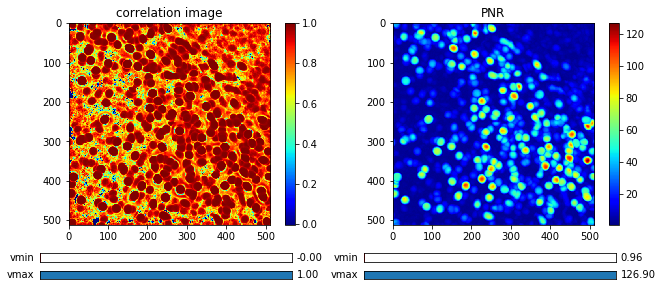

In [43]:
cn_filter, pnr = cm.summary_images.correlation_pnr(images[::5], gSig=gSig[0], swap_dim=False) # change swap dim if output looks weird, it is a problem with tiffile
# inspect the summary images and set the parameters
inspect_correlation_pnr(cn_filter, pnr)
gSig

In [44]:
%%capture
#%% RUN CNMF ON PATCHES
# First extract spatial and temporal components on patches and combine them
# for this step deconvolution is turned off (p=0). If you want to have
# deconvolution within each patch change params.patch['p_patch'] to a
# nonzero value
cnm = cnmf.CNMF(n_processes, params=opts, dview=dview)
cnm = cnm.fit(images)

In [45]:
#%% plot contours of found components
Cn = cm.local_correlations(images.transpose(1,2,0))
Cn[np.isnan(Cn)] = 0
cnm.estimates.plot_contours_nb(img=Cn)

In [46]:
%%capture
#%% RE-RUN seeded CNMF on accepted patches to refine and perform deconvolution 
cnm2 = cnm.refit(images, dview=dview)

In [47]:
#%% COMPONENT EVALUATION
# the components are evaluated in three ways:
#   a) the shape of each component must be correlated with the data
#   b) a minimum peak SNR is required over the length of a transient
#   c) each shape passes a CNN based classifier
min_SNR = 12           # adaptive way to set threshold on the transient size
r_values_min = 0.9    # threshold on space consistency (if you lower more components
#                        will be accepted, potentially with worst quality)
cnm.params.set('quality', {'min_SNR': min_SNR,
                           'rval_thr': r_values_min,
                           'use_cnn': False})
cnm2.estimates.evaluate_components(images, cnm2.params, dview=dview)

print('Number of total components: ', len(cnm2.estimates.C))
print('Number of accepted components: ', len(cnm2.estimates.idx_components)) 
print('Number of accepted components: ',len(cnm2.estimates.idx_components_bad))

Number of total components:  267
Number of accepted components:  245
Number of accepted components:  22


In [48]:
#%% PLOT COMPONENTS
cnm2.estimates.plot_contours_nb(img=Cn, idx=cnm2.estimates.idx_components)

cnm2.estimates.select_components(cnm2.estimates.idx_components)


*** Variable cnn_preds has not the same number of components as A ***
*** Variable coordinates has not the same number of components as A ***


In [49]:
# accepted components
cnm2.estimates.nb_view_components(img=Cn, idx=cnm2.estimates.idx_components)


In [50]:
# rejected components
cnm2.estimates.idx_components_bad
if not (cnm2.estimates.idx_components_bad):
    print("No components were rejected.")
elif len(cnm2.estimates.idx_components_bad) >0:
    cnm2.estimates.nb_view_components(img=Cn, idx=cnm2.estimates.idx_components_bad)
else:
    print("No components were rejected.")

No components were rejected.


In [51]:
# #%% Extract DF/F values
# dff = cnm2.estimates.detrend_df_f(quantileMin=8, frames_window=250)
# deconvolve = cnm2.estimates.deconvolve(cnm.params,dview=dview,dff_flag=True)

# print(len(cnm2.estimates.F_dff))
# print(len(cnm2.estimates.S))

In [52]:
# #%% denoised (No use)
# cnm2.estimates.nb_view_components(img=Cn, denoised_color='red')

(512, 512, 245)
245


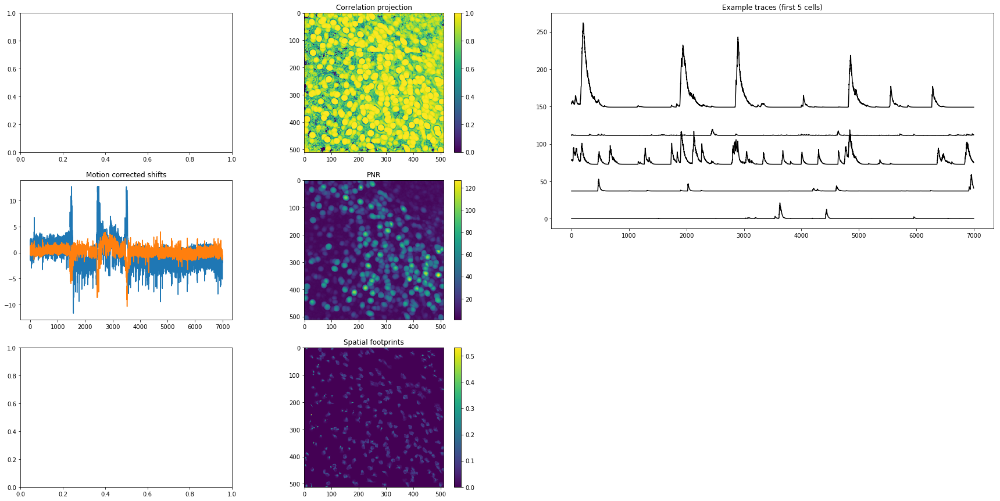

In [53]:
cnm2.estimates.detrend_df_f(quantileMin=8, frames_window=250)
if not (cnm2.estimates.idx_components_bad):
    idx_deleted=0;
elif len(cnm2.estimates.idx_components_bad) >0:
    idx_accepted=cnm2.estimates.idx_components
    idx_deleted=cnm2.estimates.idx_components_bad

#RawTraces = cnm2.estimates.C[idx_accepted,:]
#DeconvTraces = cnm2.estimates.S[idx_accepted,:]
#SFP = cnm2.estimates.A[:,idx_accepted]
RawTraces = cnm2.estimates.C
DeconvTraces = cnm2.estimates.S
SFP_sparse = cnm2.estimates.A
SFP_dims = list(dims)
SFP_dims.append(SFP_sparse.shape[1])
dff = cnm2.estimates.F_dff
SFP = np.reshape(SFP_sparse.toarray(),SFP_dims,order='F')
print(np.shape(SFP))
print(len(dff))

plot_gain = 10 # To change the value gain of traces
neuronsToPlot = 5
numNeurons = SFP_dims[2]
maxRawTraces = np.amax(RawTraces)
plt.figure(figsize=(30,15))
plt.subplot(341);
plt.subplot(345); plt.plot(mc.shifts_rig); plt.title('Motion corrected shifts')
plt.subplot(3,4,9);
plt.subplot(3,4,2); plt.imshow(cn_filter); plt.colorbar(); plt.title('Correlation projection')
plt.subplot(3,4,6); plt.imshow(pnr); plt.colorbar(); plt.title('PNR')
plt.subplot(3,4,10); plt.imshow(np.amax(SFP,axis=2)); plt.colorbar(); plt.title('Spatial footprints')

plt.subplot(2,2,2); plt.figure; plt.title('Example traces (first 5 cells)')
plot_gain = 10 # To change the value gain of traces
if numNeurons >= neuronsToPlot:
    for i in range(neuronsToPlot):
        if i == 0:
          plt.plot(RawTraces[i,:],'k')
        else:
          trace = RawTraces[i,:] + maxRawTraces*i/plot_gain
          plt.plot(trace,'k')
else:
    for i in range(numNeurons):
        if i == 0:
          plt.plot(RawTraces[i,:],'k')
        else:
          trace = RawTraces[i,:] + maxRawTraces*i/plot_gain
          plt.plot(trace,'k')


# plt.subplot(2,2,4); plt.figure; plt.title('Deconvolved traces (first 5 cells)')
# plot_gain = 20 # To change the value gain of traces
# if numNeurons >= neuronsToPlot:
#     for i in range(neuronsToPlot):
#         if i == 0:
#           plt.plot(DeconvTraces[i,:],'k')
#         else:
#           trace = DeconvTraces[i,:] + maxRawTraces*i/plot_gain
#           plt.plot(trace,'k')
# else:
#     for i in range(numNeurons):
#         if i == 0:
#           plt.plot(DeconvTraces[i,:],'k')
#         else:
#           trace = DeconvTraces[i,:] + maxRawTraces*i/plot_gain
#           plt.plot(trace,'k')  
# Save summary figure
plt.savefig(newpath_parent + '/' + 'summary_figure.eps', edgecolor='w', format='eps', transparent=True)

In [54]:
save_results = True
result_name=os.path.join(pathname,'analysis_results.hdf5')
if save_results:
    cnm2.save(result_name)


save_mat=True
if save_mat:
    from scipy.io import savemat
    
    results_dict={
        'height':dims[0],
        'width':dims[1],
        'CorrProj':cn_filter,
        'PNR':pnr,
        'sigraw':RawTraces.conj().transpose(),
        'sigdeconvolved':DeconvTraces.conj().transpose(),
        'dff':dff,
        'SFP':SFP,
        'idx_accepted':idx_accepted,
        'idx_deleted':idx_deleted
        
    }

    savemat(os.path.join(newpath_parent,'2p.mat'), {'TwoP': results_dict})
    print('.mat Files saved!')


/home/qiushou/.conda/envs/caiman/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning: dataset.value has been deprecated. Use dataset[()] instead.
  "Use dataset[()] instead.", H5pyDeprecationWarning)


TypeError: Could not convert None (type <class 'NoneType'>) to array

In [ ]:
#%% STOP CLUSTER and clean up log files
cm.stop_server(dview=dview)
log_files = glob.glob('*_LOG_*')
for log_file in log_files:
    os.remove(log_file)

In [ ]:
denoised = cm.movie(cnm2.estimates.A.dot(cnm2.estimates.C)).reshape(dims + (-1,), order='F').transpose([2, 0, 1])
denoised.save(os.path.join(newpath_parent,'denoised.avi'))